# Questions?

- Trends of Crime:
    - What are the trends of crime in Queensland over the last decade? 
    - Can we expect a rise or decline in the future?
- Juvenile Crime:
    - Is there significant spike in juvenile crime in the last decade, last 5 year period and last year?
    - Are there any specific areas where Juvenile crime is high?
    - Can we expect a rise or decline based on the recent measures?
- Victims of Crime:
    - What age group is most likely to be a victim of crime in Queensland and what nature of crime is more prevalent?

## Comment on Dataset: 

 **Data Source:** Queensland Government provides open data on [https://www.data.qld.gov.au/dataset](https://www.data.qld.gov.au/dataset).  
 This data is in collaboration with Queensland Police Service, henceforth referred to as QPS.

A search query for csv files on crime data was computed: 
[https://www.data.qld.gov.au/dataset/?tags=crime&res_format=CSV](https://www.data.qld.gov.au/dataset/?tags=crime&res_format=CSV)

The following files were downloaded for this analysis:
- **victims_url:** Victim numbers—police region—monthly from Jan 2001
- **offenders_url:** Offender numbers—police region—from Jan 2001
- **offences_url:** Offence numbers—police regions—monthly from July 2001

**NOTE:**
- For the victims dataset, 
    - it is to be noted that that one person may be counted multiple times.
    - the age range for juvenile victims is between 0-17 years, inclusive.
- For the offenders dataset, 
    - the statistics are based on number of offences solved through an action against the offender. 
    - the age range for juvenile offenders is between (and, including) 10 and 16 years (2013 onwards).
    - if the age or gender was not specified in Queensland Police Service records, the offenders were not included in this dataset.
- For the offences dataset, the data recorded is the number of reported offences per 100,000 persons.
- All these files have security classification of Public

[Queensland Police Explanatory Notes](https://www.police.qld.gov.au/sites/default/files/2019-01/AnnualStatisticalReview_2015-16_Explanatory%20Notes.pdf)


-- What KIND of data? Labelled / Unlabelled  
-- What do I want to ACHIEVE? Predict / Classify

### Further considerations:

- The analysis in this report aims to be as comprehensive as the data acquired will allow it to be.
- The data from the QPS records only the crimes that have been reported and the offenders that have been apprehended. It is to be noted that this data does not cover the entirety of the cases, such as when and where the crimes occured, how many people were involved in each case.
- The set of victims also excludes missing persons.

# Data :

Here, we will process the data from QPS using Python **(v.6.5.2)**.

Required libraries are loaded; datafiles are downloaded from the links and preprocessed via cleaning for better understanding.

In [2]:
import os
cwdir = os.getcwd()
print(cwdir)
os.chdir(cwdir)

C:\Users\Ayesha\Documents\QUT\IFN619\assign2-AyeshaMahreen-N11347473


In [3]:
import warnings
warnings.filterwarnings("ignore")

import pandas as pd
import numpy as np
import re
import matplotlib.pyplot as plt
import plotly.express as px

pd.set_option('display.max_rows', 100)
pd.set_option('display.max_columns', None)

### Uploading Data and forming the Dataframe

In [110]:
victims_url = "http://open-crime-data.s3-ap-southeast-2.amazonaws.com/Crime%20Statistics/Region_Reported_victims_Number.csv"
offenders_url = "https://open-crime-data.s3-ap-southeast-2.amazonaws.com/Crime%20Statistics/Region_Reported_Offenders_Number.csv"
offenceNr_url = "https://open-crime-data.s3-ap-southeast-2.amazonaws.com/Crime%20Statistics/region_Reported_Offences_Number.csv"

As part of initial data cleaning:
 - There were issues with structure and column headings, resulting in issues with seamless upload of the files into pandas dataframe through the links. These were identified and the column causing the issue (right hand index) was dropped.
 - Data was selected for the year 2013 and onwards to observe trends over the decade. Data for the year 2023 was dropped as at the time of the report is mid-2023. 
 - The 'Month Year' column was redefined into different Month and Year columns for 'seasonal' exploration.
 - Data columns that were related to aggregates were dropped (as per reading on QPS Annual Statistics Explanatory Notes)
 - Columns that were not similar to victims_file were dropped

In [132]:
victim_headers = pd.read_csv(victims_url, nrows=1).columns.tolist()
victims_file = pd.read_csv(victims_url, header=None, skiprows=1)
victims_file = victims_file.iloc[:, :-1]
victims_file.columns = victim_headers
print(f"UPLOADED: victims_file ! ---> dimensions: {victims_file.shape}")
victims_file['Month Year'] = pd.to_datetime(victims_file['Month Year'], format='%b%y')
victims_file = victims_file[victims_file['Month Year'].dt.year > 2012]
victims_file['Month'] = victims_file['Month Year'].dt.month_name()
victims_file['Year'] = victims_file['Month Year'].dt.strftime('%Y')
victims_file = victims_file.drop('Month Year', axis=1)


offences_headers = pd.read_csv(offenceNr_url, nrows=1).columns.tolist()
offences_file = pd.read_csv(offences_url, header=None, skiprows=1)
offences_file = offences_file.iloc[:, :-1]
offences_file.columns = offences_headers
print(f"UPLOADED: offences_file ! ---> dimensions: {offences_file.shape}")
offences_file['Month Year'] = pd.to_datetime(offences_file['Month Year'], format='%b%y')
offences_file = offences_file[offences_file['Month Year'].dt.year > 2012]
offences_file['Month'] = offences_file['Month Year'].dt.month_name()
offences_file['Year'] = offences_file['Month Year'].dt.strftime('%Y')
offences_file = offences_file.drop('Month Year', axis=1)
#offences_file

mask = offenders_file.columns.isin(victims_file.columns)
offenders_file = offenders_file.loc[:, mask]

mask = offences_file.columns.isin(victims_file.columns)
offences_file = offences_file.loc[:, mask]

print(f"UPDATED: victims_file ! ---> dimensions: {victims_file.shape}")
print(f"UPDATED: offenders_file ! ---> dimensions: {offenders_file.shape}")
print(f"UPDATED: offences_file ! ---> dimensions: {offences_file.shape}")

UPLOADED: victims_file ! ---> dimensions: (11256, 29)
UPLOADED: offenders_file ! ---> dimensions: (11256, 93)
UPLOADED: offences_file ! ---> dimensions: (1876, 91)
UPDATED: victims_file ! ---> dimensions: (5208, 30)
UPDATED: offenders_file ! ---> dimensions: (5208, 30)
UPDATED: offences_file ! ---> dimensions: (868, 28)


In [141]:
offenders_headers = pd.read_csv(offenders_url, nrows=1).columns.tolist()
offenders_file = pd.read_csv(offenders_url, header=None, skiprows=1)
offenders_file = offenders_file.iloc[:, :-1]
offenders_file.columns = offenders_headers
print(f"UPLOADED: offenders_file ! ---> dimensions: {offenders_file.shape}")
offenders_file['Month Year'] = pd.to_datetime(offenders_file['Month Year'], format='%b%y')
offenders_file = offenders_file[offenders_file['Month Year'].dt.year > 2012]
offenders_file['Month'] = offenders_file['Month Year'].dt.month_name()
offenders_file['Year'] = offenders_file['Month Year'].dt.strftime('%Y')
offenders_file = offenders_file.drop('Month Year', axis=1)
#offenders_file

UPLOADED: offenders_file ! ---> dimensions: (11256, 93)


In [ ]:
offenders

In [127]:
import pandas as pd

# Assuming you have offenders_df and offenses_df as the offender and offense datasets

# Step 1: Aggregate the data by region and time period
offenders_agg = offenders_file.groupby(['Region', 'Year']).sum()
offences_agg = offences_file.groupby(['Region', 'Year']).sum()

# Step 2: Calculate the total number of offenders
total_offenders = offenders_agg['Offences Against the Person']

# Step 3: Calculate the total number of offenses
total_offences = offences_agg['Offences Against the Person']

# Step 4: Calculate the ratio of offenders to offenses
ratio = total_offenders / total_offences

# Print the result
print(ratio)

Region         Year
Brisbane       2013    8.440182
               2014    8.509839
               2015    8.447710
               2016    8.436691
               2017    8.539379
               2018    8.882476
               2019    9.009751
               2020    9.211514
               2021    7.529534
               2022    6.543727
               2023    5.960615
Central        2013    2.760555
               2014    2.778941
               2015    2.636707
               2016    2.609618
               2017    2.497169
               2018    2.438040
               2019    2.405987
               2020    2.424640
               2021    1.938649
               2022    1.713583
               2023    1.701607
Far Northern   2013    1.942313
               2014    2.031840
               2015    1.948611
               2016    2.020774
               2017    1.873819
               2018    1.907686
               2019    1.910049
               2020    1.981952
               2021 

In [143]:
# Dropping columns that aggregate up to "Assault"
offenders_file = offenders_file.drop(['Grievous Assault', 'Serious Assault', 'Serious Assault (Other)', 'Common Assault\''], axis=1)

In [145]:
# Dropping columns that aggregate upto "Sexual Offences" and "Robbery"
offenders_file = offenders_file.drop(['Rape and Attempted Rape', 'Other Sexual Offences', 'Armed Robbery', 'Unarmed Robbery'], axis=1)

In [148]:
# Dropping columns that aggregate upto "Other Offences Against the Person"
offenders_file = offenders_file.drop(['Kidnapping & Abduction etc.', 'Extortion', 'Stalking', 'Life Endangering Acts', 'Voluntary Assisted Dying'], axis=1)

In [150]:
# Dropping columns that aggregate upto "Other Homicide"
offenders_file = offenders_file.drop(['Attempted Murder', 'Conspiracy to Murder', 'Manslaughter (excl. by driving)', 'Manslaughter Unlawful Striking Causing Death', 'Driving Causing Death'], axis=1)

In [152]:
# Offences Against the Person = Assault + Sexual Offences + Robbery + Other Offences Against the Person + Homicide + Other Homicide

offenders_file = offenders_file.drop(['Assault', 'Sexual Offences', 'Robbery', 'Other Offences Against the Person', 'Homicide (Murder)', 'Other Homicide'], axis=1)

In [153]:
offenders_file.groupby('Year').sum()

,Offences Against the Person,Unlawful Entry,Unlawful Entry With Intent - Dwelling,Unlawful Entry Without Violence - Dwelling,Unlawful Entry With Violence - Dwelling,Unlawful Entry With Intent - Shop,Unlawful Entry With Intent - Other,Arson,Other Property Damage,Unlawful Use of Motor Vehicle,Other Theft (excl. Unlawful Entry),Stealing from Dwellings,Shop Stealing,Vehicles (steal from/enter with intent),Other Stealing,Fraud,Fraud by Computer,Fraud by Cheque,Fraud by Credit Card,Identity Fraud,Other Fraud,Handling Stolen Goods,Possess Property Suspected Stolen,Receiving Stolen Property,Possess etc. Tainted Property,Other Handling Stolen Goods,Offences Against Property,Drug Offences,Trafficking Drugs,Possess Drugs,Produce Drugs,Sell Supply Drugs,Other Drug Offences,Prostitution Offences,Found in Places Used for Purpose of Prostitution Offences,Have Interest in Premises Used for Prostitution Offences,Knowingly Participate in Provision Prostitution Offences,Public Soliciting,Procuring Prostitution,Permit Minor to be at a Place Used for Prostitution Offences,Advertising Prostitution,Other Prostitution Offences,Liquor (excl. Drunkenness),Gaming Racing & Betting Offences,Breach Domestic Violence Protection Order,Trespassing and Vagrancy,Weapons Act Offences,Unlawful Possess Concealable Firearm,Unlawful Possess Firearm - Other,Bomb Possess and/or use of,Possess and/or use other weapons; restricted items,Weapons Act Offences - Other,Good Order Offences,Disobey Move-on Direction,Resist Incite Hinder Obstruct Police,Fare Evasion,Public Nuisance,Stock Related Offences,Traffic and Related Offences,Dangerous Operation of a Vehicle,Drink Driving,Disqualified Driving,Interfere with Mechanism of Motor Vehicle,Miscellaneous Offences,Other Offences
Year,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2013,18985,13204,7281,6874,407,1417,4506,287,12780,6240,28224,1380,12809,5021,9014,9864,299,318,3659,249,5339,4872,1822,543,2458,49,75471,55345,331,24923,1721,1848,26522,95,7,6,52,7,6,1,0,16,7287,0,13146,4285,4178,122,502,12,2102,1440,49617,1190,19245,2424,26758,417,40992,1339,26102,13535,16,2729,178091
2014,18715,12464,7014,6534,480,1055,4395,389,11578,5364,30505,1438,13745,4866,10456,10599,388,216,5249,210,4536,4730,1851,488,2341,50,75629,67751,407,30345,1976,2078,32945,63,0,2,42,4,4,0,4,7,7504,0,15343,5046,5163,114,681,7,1889,2472,55058,1268,22431,3197,28162,570,39215,1458,25074,12672,11,2950,198663
2015,18459,12323,6680,6132,548,1106,4537,285,10957,5507,32019,1434,14965,4997,10623,10311,76,169,5538,285,4243,4890,2044,467,2344,35,76292,78172,617,34835,1800,2746,38174,118,10,1,34,34,7,0,6,26,5809,0,18477,5518,5846,154,671,8,2063,2950,55025,960,23710,3498,26857,564,41492,1550,27486,12446,10,3368,214389
2016,21084,13978,7961,7353,608,928,5089,350,12522,7113,35848,1469,16381,5843,12155,11130,42,140,6598,247,4103,5396,2285,458,2622,31,86337,81474,626,36433,1786,2793,39836,55,4,1,30,4,1,0,8,7,5070,2,22679,6172,6315,123,703,9,2095,3385,56324,933,24243,5189,25959,291,43937,1572,29944,12404,17,3645,225964
2017,21830,13953,8073,7463,610,1063,4817,321,12392,7413,35799,1392,16037,5549,12821,11726,74,106,6581,327,4638,5035,2062,434,2492,47,86639,70601,532,31864,1517,2243,34445,102,2,6,45,2,0,0,21,26,4730,1,20975,5980,5801,118,618,25,1815,3225,50031,821,20853,4313,24044,138,39835,1547,28264,10010,14,2649,200843
2018,21805,14488,7664,7088,576,1248,5576,368,12005,8254,39538,1341,17763,5918,14516,12278,83,96,7224,368,4507,5731,2608,378,2697,48,92662,72247,497,32906,1570,2176,35098,74,0,1,46,0,1,0,5,21,3775,0,18714,6197,6767,132,589,25,2105,3916,47559,758,19703,4153,22945,26,42444,1650,30640,10147,7,2666,200469
2019,21503,15178,8640,8045,595,1224,5314,406,11401,9264,42852,1340,19814,6399,15299,11066,104,88,6460,348,4066,6165,2849,469,2818,29,96332,75036,554,35106,1684,2146,35546,59,0,2,43,1,1,0,2,10,3246,1,19388,6120,7418,120,615,28,2215,4440,44539,761,19664,2743,21371,34,42272,1762,29799,10702,9,2782,200895
2020,23525,15356,8573,7911,662,1555,5228,

In [ ]:
# Dropping Offences Against the Person which is an aggregate
victims_file = victims_file.drop(['Offences Against the Person'], axis=1)

### Data cleaning:

Designing a customized function to thoroughly check Dataframe entries and details such as:
- Data type and count of every column
- No. of NaNs and Blanks or presense of special characters in the column entries
- presence of any expression that does not align with the correctness of data in the column

In [118]:
pd.set_option('display.max_rows', None)

datasets = [victims_file, offenders_file, offences_file]
def detail_check():
    for sets in datasets:
        for i in sets.columns:
            print(f"{i}>>{offenders_file[i].dtype}>>{offenders_file[i].count()}")
            #print(offenders_file[i].unique().tolist())
            #print(offenders_file[i].isna().sum())
        
#detail_check()

The final datasets are satisfactory and do not contain any NAs or Missing values.

In [114]:
#!pip install xlsxwriter

crimes_sheet = pd.ExcelWriter('Clean_Crimes.xlsx')

# Write each DataFrame to a separate sheet in the Excel file
victims_file.to_excel(crimes_sheet, sheet_name='Victims', index=False)
offenders_file.to_excel(crimes_sheet, sheet_name='Offenders', index=False)
offences_file.to_excel(crimes_sheet, sheet_name='Offences', index=False)

# Save the Excel file
crimes_sheet.save()
print(f"File saved at: {cwdir}")

File saved at: C:\Users\Ayesha\Documents\QUT\IFN619\assign2-AyeshaMahreen-N11347473


# Analysis:

### Understanding the data:

In [115]:
offenders_file.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5208 entries, 864 to 11255
Data columns (total 30 columns):
 #   Column                                        Non-Null Count  Dtype 
---  ------                                        --------------  ----- 
 0   Region                                        5208 non-null   object
 1   Age                                           5208 non-null   object
 2   Sex                                           5208 non-null   object
 3   Homicide (Murder)                             5208 non-null   int64 
 4   Other Homicide                                5208 non-null   int64 
 5   Attempted Murder                              5208 non-null   int64 
 6   Conspiracy to Murder                          5208 non-null   int64 
 7   Manslaughter (excl. by driving)               5208 non-null   int64 
 8   Manslaughter Unlawful Striking Causing Death  5208 non-null   int64 
 9   Driving Causing Death                         5208 non-null   int64 
 1

In [92]:
# No.of records:
offRec = offenders_file.size
# No. of rows:
off_rows = offenders_file.shape[0]
# No. of columns:
off_cols = offenders_file.shape[1]

# Report information
print(f"The final Dataframe has {off_rows} rows and {off_cols} columns with a total of {offRec} records in it.")

The final Dataframe has 5208 rows and 16 columns with a total of 83328 records in it.


In [95]:
offenders_file.describe()

,Homicide (Murder),Other Homicide,Attempted Murder,Conspiracy to Murder,Manslaughter (excl. by driving),Manslaughter Unlawful Striking Causing Death,Driving Causing Death,Assault,Sexual Offences,Robbery,Other Offences Against the Person
count,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000
mean,0.121352,0.166859,0.094470,0.002112,0.013441,0.003648,0.053187,29.839478,5.396697,3.527266,5.165131
std,0.550382,0.584677,0.455325,0.057100,0.118452,0.069195,0.251848,39.211304,10.374386,5.937873,9.448556
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17.000000,0.000000,1.000000,1.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,36.000000,5.000000,5.000000,5.000000
max,15.000000,15.000000,15.000000,2.000000,2.000000,2.000000,3.000000,210.000000,108.000000,60.000000,67.000000


In [96]:
victims_file.describe()

,Homicide (Murder),Other Homicide,Attempted Murder,Conspiracy to Murder,Manslaughter (excl. by driving),Manslaughter Unlawful Striking Causing Death,Driving Causing Death,Assault,Sexual Offences,Robbery,Other Offences Against the Person
count,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000,5208.000000
mean,0.091590,0.162634,0.095622,0.002304,0.012865,0.003264,0.048579,54.506144,11.063172,3.172811,7.863671
std,0.342079,0.511299,0.388618,0.047951,0.117703,0.060318,0.241112,75.199592,15.193283,5.218087,13.232634
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,24.000000,4.000000,1.000000,3.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,81.000000,17.000000,4.000000,10.000000
max,4.000000,8.000000,6.000000,1.000000,2.000000,2.000000,3.000000,455.000000,109.000000,43.000000,143.000000


In [97]:
offenders_file.tail(15)

,Region,Age,Sex,Homicide (Murder),Other Homicide,Attempted Murder,Conspiracy to Murder,Manslaughter (excl. by driving),Manslaughter Unlawful Striking Causing Death,Driving Causing Death,Assault,Sexual Offences,Robbery,Other Offences Against the Person,Month,Year
11241,Southern,Juvenile,Female,0,0,0,0,0,0,0,31,4,8,4,February,2023
11242,Southern,Juvenile,Male,2,0,0,0,0,0,0,18,2,17,4,February,2023
11243,Southern,Juvenile,Not Stated,0,0,0,0,0,0,0,0,0,0,0,February,2023
11244,Southern,Adult,Female,0,1,0,0,0,0,1,48,1,3,8,March,2023
11245,Southern,Adult,Male,1,1,0,0,0,0,1,113,34,17,52,March,2023
11246,Southern,Adult,Not Stated,0,0,0,0,0,0,0,0,0,0,0,March,2023
11247,Southern,Juvenile,Female,0,0,0,0,0,0,0,33,1,2,0,March,2023
11248,Southern,Juvenile,Male,0,0,0,0,0,0,0,30,9,3,1,March,2023
11249,Southern,Juvenile,Not Stated,0,0,0,0,0,0,0,0,0,0,0,March,2023
11250,Southern,Adult,Female,0,0,0,0,0,0,0,37,2,0,5,April,2023


In [117]:
offenders_file.groupby(['Region'])['Assault'].sum()

Region
Brisbane         27325
Central          16186
Far Northern     21935
North Coast      24093
Northern         21552
South Eastern    23369
Southern         20944
Name: Assault, dtype: int64

In [98]:
vicbyAge = victims_file.groupby(['Age']).sum()
vicbyAge

,Homicide (Murder),Other Homicide,Attempted Murder,Conspiracy to Murder,Manslaughter (excl. by driving),Manslaughter Unlawful Striking Causing Death,Driving Causing Death,Assault,Sexual Offences,Robbery,Other Offences Against the Person
Age,,,,,,,,,,,
Adult,413,731,432,12,45,17,225,237508,26700,12237,33084
Juvenile,64,116,66,0,22,0,28,46360,30917,4287,7870


In [99]:
offbyAge = offenders_file.groupby(['Age']).sum()
offbyAge

,Homicide (Murder),Other Homicide,Attempted Murder,Conspiracy to Murder,Manslaughter (excl. by driving),Manslaughter Unlawful Striking Causing Death,Driving Causing Death,Assault,Sexual Offences,Robbery,Other Offences Against the Person
Age,,,,,,,,,,,
Adult,596,802,443,9,69,18,263,124447,22553,9770,23545
Juvenile,36,67,49,2,1,1,14,30957,5553,8600,3355


In [100]:
pivot_offAge = pd.pivot_table(data=offbyAge, columns=['Age'])
pivot_offAge.columns = ['Adult offenders', 'Juvenile offenders']
pivot_offAge = pivot_offAge.rename_axis('Crimes')
pivot_offAge

,Adult offenders,Juvenile offenders
Crimes,,
Assault,124447,30957
Attempted Murder,443,49
Conspiracy to Murder,9,2
Driving Causing Death,263,14
Homicide (Murder),596,36
Manslaughter (excl. by driving),69,1
Manslaughter Unlawful Striking Causing Death,18,1
Other Homicide,802,67
Other Offences Against the Person,23545,3355


In [101]:
pivot_vicAge = pd.pivot_table(data=vicbyAge, columns=['Age'])
pivot_vicAge.columns = ['Adult victims', 'Juvenile victims']
pivot_vicAge = pivot_vicAge.rename_axis('Crimes')
pivot_vicAge

,Adult victims,Juvenile victims
Crimes,,
Assault,237508,46360
Attempted Murder,432,66
Conspiracy to Murder,12,0
Driving Causing Death,225,28
Homicide (Murder),413,64
Manslaughter (excl. by driving),45,22
Manslaughter Unlawful Striking Causing Death,17,0
Other Homicide,731,116
Other Offences Against the Person,33084,7870


In [102]:
pivotAge = pivot_offAge.join(pivot_vicAge)
pivotAge

,Adult offenders,Juvenile offenders,Adult victims,Juvenile victims
Crimes,,,,
Assault,124447,30957,237508,46360
Attempted Murder,443,49,432,66
Conspiracy to Murder,9,2,12,0
Driving Causing Death,263,14,225,28
Homicide (Murder),596,36,413,64
Manslaughter (excl. by driving),69,1,45,22
Manslaughter Unlawful Striking Causing Death,18,1,17,0
Other Homicide,802,67,731,116
Other Offences Against the Person,23545,3355,33084,7870


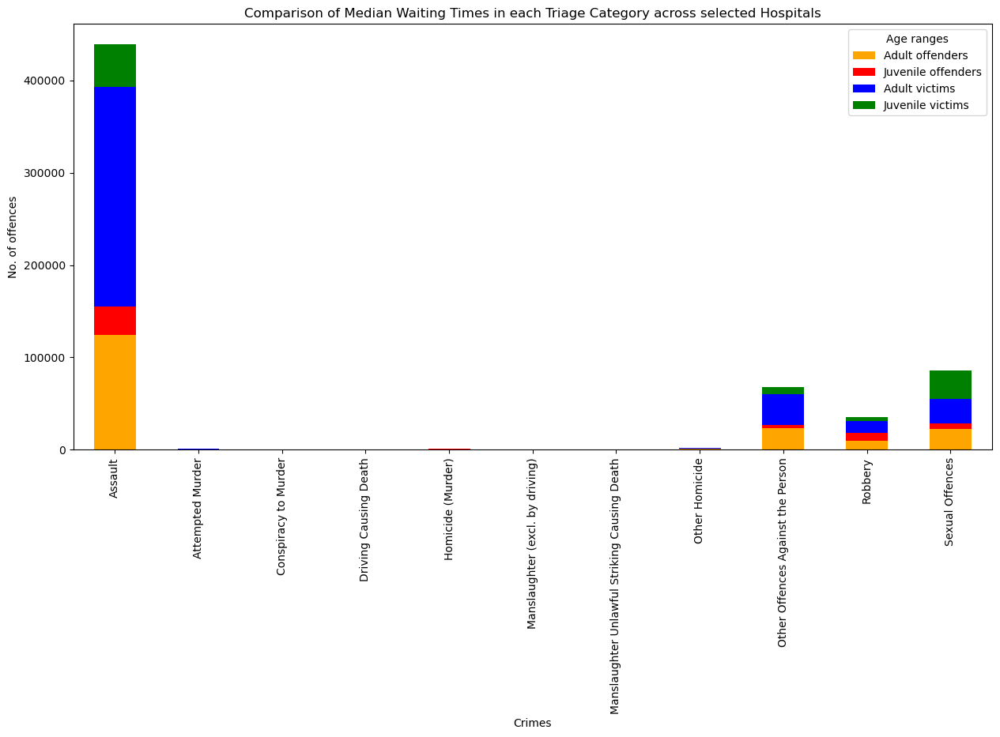

In [103]:
ax = pivotAge.plot.bar(color=['orange','red', 'blue', 'green'], figsize=(15,7), rot=90, stacked=True)
ax.set_title("Comparison of Median Waiting Times in each Triage Category across selected Hospitals")
ax.set_xlabel('Crimes')
ax.set_ylabel('No. of offences')
ax.legend(title="Age ranges")

In [130]:
offenders_file.groupby('Month').sum()

,Homicide (Murder),Other Homicide,Attempted Murder,Conspiracy to Murder,Manslaughter (excl. by driving),Manslaughter Unlawful Striking Causing Death,Driving Causing Death,Assault,Grievous Assault,Serious Assault,Serious Assault (Other),Common Assault',Sexual Offences,Rape and Attempted Rape,Other Sexual Offences,Robbery,Armed Robbery,Unarmed Robbery,Other Offences Against the Person,Kidnapping & Abduction etc.,Extortion,Stalking,Life Endangering Acts,Voluntary Assisted Dying,Offences Against the Person
Month,,,,,,,,,,,,,,,,,,,,,,,,,
April,56,74,41,0,11,0,22,12672,623,5793,1943,4313,2224,627,1597,1533,714,819,2257,233,56,414,1554,0,18816
August,49,87,51,0,9,0,27,12682,584,5899,1862,4337,2433,651,1782,1413,715,698,2238,223,46,361,1608,0,18902
December,50,54,28,0,5,1,20,12965,646,5933,2011,4375,2151,619,1532,1500,789,711,2209,255,65,356,1533,0,18929
February,69,65,38,1,8,2,16,13759,680,6585,2027,4467,2467,640,1827,1614,843,771,2406,269,63,385,1689,0,20380
January,47,64,35,4,1,4,20,13886,727,6493,2150,4516,2430,696,1734,1797,857,940,2407,260,40,368,1739,0,20631
July,63,73,30,2,6,3,32,12005,635,5450,1769,4151,2130,561,1569,1436,652,784,2138,222,51,364,1501,0,17845
June,41,69,30,1,5,2,31,11601,530,5317,1754,4000,2136,611,1525,1398,707,691,1956,236,30,279,1411,0,17201
March,59,84,48,1,4,1,30,15231,701,7163,2300,5067,2733,795,1938,1718,814,904,2651,298,64,468,1821,0,22476
May,44,55,37,0,3,0,15,11945,613,5502,1911,3919,2268,609,1659,1270,609,661,2021,197,50,351,1423,0,17603


In [120]:
offenders_file.groupby('Year').sum()

,Homicide (Murder),Other Homicide,Attempted Murder,Conspiracy to Murder,Manslaughter (excl. by driving),Manslaughter Unlawful Striking Causing Death,Driving Causing Death,Assault,Grievous Assault,Serious Assault,Serious Assault (Other),Common Assault',Sexual Offences,Rape and Attempted Rape,Other Sexual Offences,Robbery,Armed Robbery,Unarmed Robbery,Other Offences Against the Person,Kidnapping & Abduction etc.,Extortion,Stalking,Life Endangering Acts,Voluntary Assisted Dying,Offences Against the Person
Year,,,,,,,,,,,,,,,,,,,,,,,,,
2013,43,89,52,3,6,0,28,13103,738,5585,2104,4676,2338,494,1844,1372,779,593,2040,209,55,315,1461,0,18985
2014,51,88,53,2,8,0,25,12849,650,5916,1878,4405,2678,593,2085,1056,605,451,1993,231,57,375,1330,0,18715
2015,70,80,49,2,5,1,23,12691,702,5855,1875,4259,2541,661,1880,1177,625,552,1900,249,66,334,1251,0,18459
2016,53,96,50,2,11,8,25,14641,677,6938,2202,4824,2606,626,1980,1377,726,651,2311,278,42,384,1607,0,21084
2017,44,79,46,1,6,1,25,14734,745,7137,2136,4716,2504,707,1797,1569,709,860,2900,273,72,371,2184,0,21830
2018,60,74,42,0,5,0,27,14397,749,6881,2075,4692,2690,787,1903,2031,1008,1023,2553,289,62,383,1819,0,21805
2019,73,62,39,0,6,1,16,14038,713,6620,2118,4587,2626,784,1842,2313,1152,1161,2391,290,61,380,1660,0,21503
2020,76,83,43,0,7,5,28,15700,831,7022,2644,5203,2801,828,1973,2218,1033,1185,2647,327,50,435,1835,0,23525
2021,63,111,59,1,8,3,40,17458,785,7826,2788,6059,3081,943,2138,2190,1039,1151,3146,296,47,531,2272,0,26049


---

# Visualisation:

<Axes: xlabel='Year'>

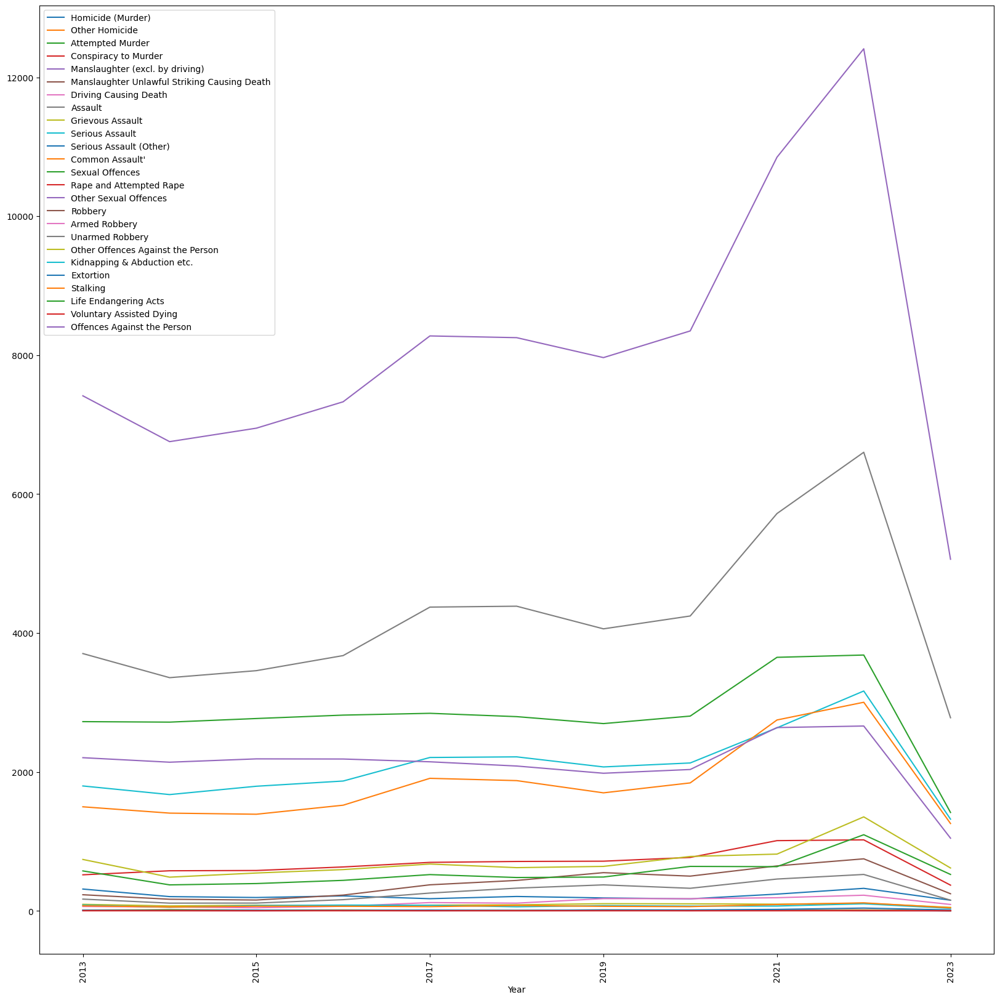

In [121]:
juv_vic = victims_file[victims_file['Age']=='Juvenile']
vicYear = juv_vic.groupby(['Year']).sum()
vicYear
#pivot_vicYr = pd.pivot_table(data=vicYear, columns=['Month Year', 'Age'])


#pivot_vicYr.columns = ['Adult offenders', 'Juvenile offenders']
vicYear.plot(kind='line', figsize=(20,20), rot=90)

<Axes: xlabel='Year'>

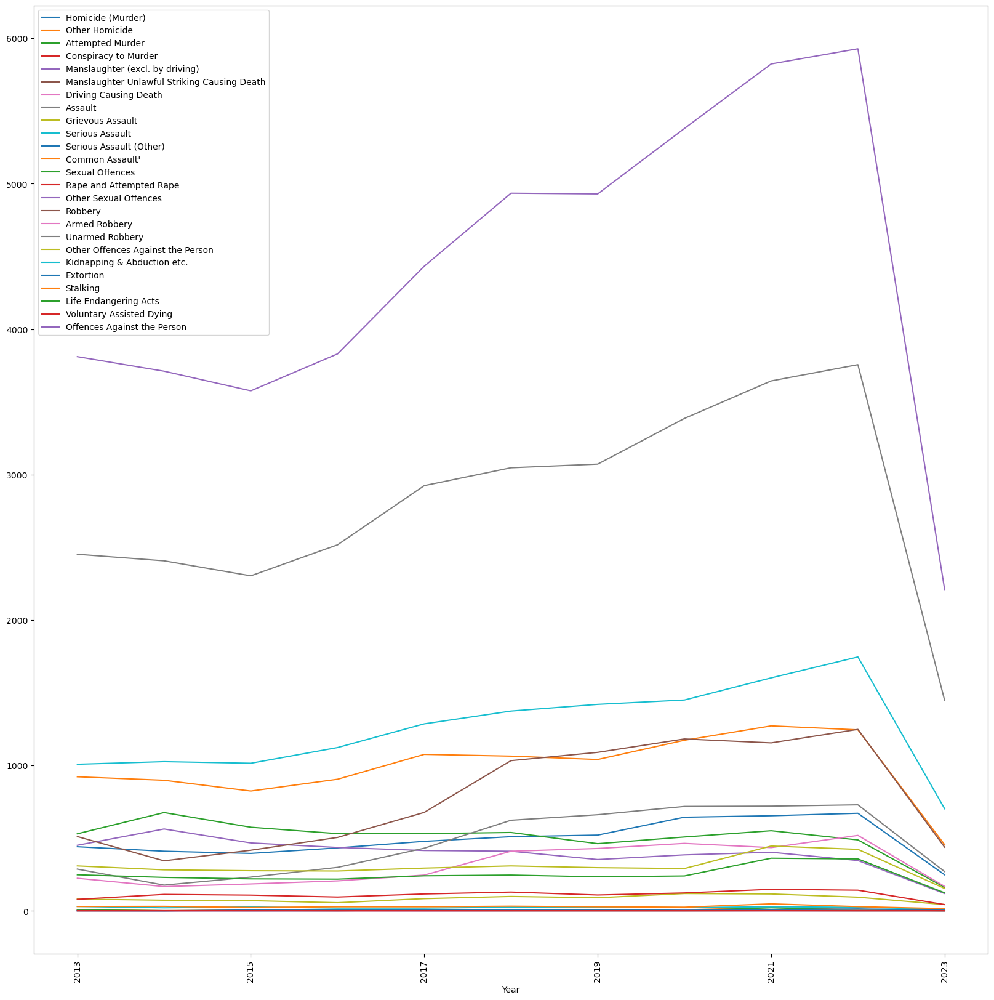

In [122]:
juv_off = offenders_file[offenders_file['Age']=='Juvenile']
offYear = juv_off.groupby(['Year']).sum()
offYear
#pivot_vicYr = pd.pivot_table(data=vicYear, columns=['Month Year', 'Age'])


#pivot_vicYr.columns = ['Adult offenders', 'Juvenile offenders']
offYear.plot(kind='line', figsize=(20,20), rot=90)

In [57]:
emergency_DF.describe()

,ED_ATTENDANCES,Nr_ATTENDANCES_in_TIME,Pc_ATTENDANCES_in_TIME,Nr_NO_WAIT,Pc_NO_WAIT,Nr_ADMITTED,Pc_ADMITTED,Nr_ADMITTED_in_4,Pc_ADMITTED_in_4,Med_WTIME
count,1884.000000,1884.000000,1884.000000,1884.000000,1884.000000,1884.000000,1884.000000,1884.000000,1884.000000,1884.000000
mean,769.074310,526.851380,80.817622,31.796178,2.405287,125.290870,12.574076,56.165605,43.731067,8.432325
std,5697.269551,3890.821056,29.487084,247.082790,4.345307,960.330023,21.234383,429.363496,41.671054,12.720235
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,9.000000,8.000000,74.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,54.000000,45.000000,95.000000,0.000000,0.000000,2.000000,3.000000,1.000000,40.000000,1.000000
75%,241.250000,186.000000,100.000000,6.000000,4.000000,12.250000,14.237500,8.000000,92.895000,13.000000
max,126615.000000,83763.000000,100.000000,6188.000000,100.000000,20123.000000,100.000000,9277.000000,100.000000,83.000000


In [58]:
# Storing ALL columns in the DF as a list
emer_cols = list(emergency_DF.columns)

# Storing ONLY numerical columns as a list
nr_cols = list(emergency_DF.describe().columns)

# The other columns could be categorical
cat_cols = set(emer_cols) - set(nr_cols)

In [59]:
print(f"The {em_cols} Columns are {emer_cols}.")

The 15 Columns are ['H_CODE', 'H_NAME', 'MONTH', 'TRIAGE_CAT', 'ED_ATTENDANCES', 'Nr_ATTENDANCES_in_TIME', 'Pc_ATTENDANCES_in_TIME', 'Nr_NO_WAIT', 'Pc_NO_WAIT', 'Nr_ADMITTED', 'Pc_ADMITTED', 'Nr_ADMITTED_in_4', 'Pc_ADMITTED_in_4', 'Med_WTIME', 'WEB_PERFORMANCE'].


In [60]:
print(f"Out of these: \nNUMERICAL: {nr_cols} and \nCATEGORICAL: {cat_cols}.")

Out of these: 
NUMERICAL: ['ED_ATTENDANCES', 'Nr_ATTENDANCES_in_TIME', 'Pc_ATTENDANCES_in_TIME', 'Nr_NO_WAIT', 'Pc_NO_WAIT', 'Nr_ADMITTED', 'Pc_ADMITTED', 'Nr_ADMITTED_in_4', 'Pc_ADMITTED_in_4', 'Med_WTIME'] and 
CATEGORICAL: {'H_NAME', 'TRIAGE_CAT', 'H_CODE', 'MONTH', 'WEB_PERFORMANCE'}.


# Visualization

In [22]:
from sklearn.preprocessing import minmax_scale

from sklearn.cluster import KMeans
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression

from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report

In [27]:
offenders_file['Year'].unique()

array(['2013', '2014', '2015', '2016', '2017', '2018', '2019', '2020',
       '2021', '2022', '2023'], dtype=object)

In [28]:
# Convert Text to numbers

offenders_LR = offenders_file
offenders = offenders_file

region_map = {'Brisbane':1, 'Central':2, 'Far Northern':3, 'North Coast':4, 'Northern':5, 'South Eastern':6, 'Southern':7}
age_map = {'Adult':1, 'Juvenile':2}
sex_map = {'Female':1, 'Male':2, 'Not Stated':0}
month_map = {'January':1, 'February':2, 'March':3, 'April':4, 'May':5, 'June':6, 
             'July':7, 'August':8, 'September':9, 'October':10, 'November':11, 'December':12}
year_map = {'2013':1, '2014':2, '2015':3, '2016':4, '2017':5, '2018':6, '2019':7, '2020':8,'2021':9, '2022':10, '2023':11}
# Get numeric values for Role
offenders["Region"] = offenders['Region'].apply(lambda x: region_map[x])
offenders["Age"] = offenders['Age'].apply(lambda x: age_map[x])
offenders["Sex"] = offenders['Sex'].apply(lambda x: sex_map[x])
offenders["Month"] = offenders['Month'].apply(lambda x: month_map[x])
offenders["Year"] = offenders['Year'].apply(lambda x: year_map[x])
offenders

,Region,Age,Sex,Homicide (Murder),Other Homicide,Attempted Murder,Conspiracy to Murder,Manslaughter (excl. by driving),Manslaughter Unlawful Striking Causing Death,Driving Causing Death,Assault,Grievous Assault,Serious Assault,Serious Assault (Other),Common Assault',Sexual Offences,Rape and Attempted Rape,Other Sexual Offences,Robbery,Armed Robbery,Unarmed Robbery,Other Offences Against the Person,Kidnapping & Abduction etc.,Extortion,Stalking,Life Endangering Acts,Voluntary Assisted Dying,Offences Against the Person,Month,Year
864,1,1,1,0,0,0,0,0,0,0,23,1,8,6,8,0,0,0,1,1,0,4,0,0,1,3,0,28,1,1
865,1,1,2,0,0,0,0,0,0,0,134,9,62,16,47,31,6,25,21,18,3,16,3,0,3,10,0,202,1,1
866,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1
867,1,2,1,0,0,0,0,0,0,0,16,0,10,1,5,0,0,0,13,6,7,1,0,0,0,1,0,30,1,1
868,1,2,2,0,0,0,0,0,0,0,34,0,16,5,13,4,0,4,7,3,4,14,0,1,1,12,0,59,1,1
869,1,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1
870,1,1,1,0,0,0,0,0,0,0,27,3,10,2,12,2,0,2,3,2,1,3,0,0,0,3,0,35,2,1
871,1,1,2,0,0,0,0,0,0,0,116,5,63,15,33,20,2,18,23,21,2,17,1,0,3,13,0,176,2,1
872,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,1
873,1,2,1,0,0,0,0,0,0,0,12,0,7,3,2,0,0,0,2,0,2,0,0,0,0,0,0,14,2,1


In [29]:
minmax_scale(offenders)

array([[0.        , 0.        , 0.5       , ..., 0.07821229, 0.        ,
        0.        ],
       [0.        , 0.        , 1.        , ..., 0.56424581, 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       ...,
       [1.        , 1.        , 0.5       , ..., 0.03631285, 0.27272727,
        1.        ],
       [1.        , 1.        , 1.        , ..., 0.12569832, 0.27272727,
        1.        ],
       [1.        , 1.        , 0.        , ..., 0.0027933 , 0.27272727,
        1.        ]])

In [30]:
km2 = KMeans(n_clusters=2, random_state=0).fit(offenders)
offenders['km2'] = km2.labels_
km3 = KMeans(n_clusters=3, random_state=0).fit(offenders)
offenders['km3'] = km3.labels_
km4 = KMeans(n_clusters=4, random_state=0).fit(offenders)
offenders['km4'] = km4.labels_

offenders

,Region,Age,Sex,Homicide (Murder),Other Homicide,Attempted Murder,Conspiracy to Murder,Manslaughter (excl. by driving),Manslaughter Unlawful Striking Causing Death,Driving Causing Death,Assault,Grievous Assault,Serious Assault,Serious Assault (Other),Common Assault',Sexual Offences,Rape and Attempted Rape,Other Sexual Offences,Robbery,Armed Robbery,Unarmed Robbery,Other Offences Against the Person,Kidnapping & Abduction etc.,Extortion,Stalking,Life Endangering Acts,Voluntary Assisted Dying,Offences Against the Person,Month,Year,km2,km3,km4
864,1,1,1,0,0,0,0,0,0,0,23,1,8,6,8,0,0,0,1,1,0,4,0,0,1,3,0,28,1,1,0,2,0
865,1,1,2,0,0,0,0,0,0,0,134,9,62,16,47,31,6,25,21,18,3,16,3,0,3,10,0,202,1,1,1,1,1
866,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,2
867,1,2,1,0,0,0,0,0,0,0,16,0,10,1,5,0,0,0,13,6,7,1,0,0,0,1,0,30,1,1,0,2,0
868,1,2,2,0,0,0,0,0,0,0,34,0,16,5,13,4,0,4,7,3,4,14,0,1,1,12,0,59,1,1,0,2,0
869,1,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,2
870,1,1,1,0,0,0,0,0,0,0,27,3,10,2,12,2,0,2,3,2,1,3,0,0,0,3,0,35,2,1,0,2,0
871,1,1,2,0,0,0,0,0,0,0,116,5,63,15,33,20,2,18,23,21,2,17,1,0,3,13,0,176,2,1,1,1,1
872,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,1,0,0,2
873,1,2,1,0,0,0,0,0,0,0,12,0,7,3,2,0,0,0,2,0,2,0,0,0,0,0,0,14,2,1,0,0,2


In [32]:
fig = px.scatter_3d(offenders, x='Assault', y='Age', z='Sex', color='km4')
fig.show()

In [34]:
new_df = pd.DataFrame([[100,2,2]],columns=['Assault','Age','Sex'])

#km4.predict(new_df)

In [44]:
offenders_LR = offenders_file

offenders_corr = offenders_LR.corr()

fig=px.imshow(offenders_corr, color_continuous_scale='thermal', text_auto=True)
fig.update_layout(height=1000, width=1000)
fig.show()